# Анализ поездок в такси. 

## Часть 1: EDA.

В этой части немного более подробно рассмотрим данные -- распределения, статистические характеристики, корреляции.

In [34]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

%matplotlib inline

df_filename = './data/Taxi_Trips_Clean.zip'

In [35]:
df = pd.read_csv(df_filename)
df.columns

Index(['Trip ID', 'Taxi ID', 'Trip Start Timestamp', 'Trip End Timestamp',
       'Trip Seconds', 'Trip Miles', 'Pickup Community Area',
       'Dropoff Community Area', 'Fare', 'Tips', 'Tolls', 'Extras',
       'Trip Total', 'Payment Type', 'Company', 'Pickup Centroid Latitude',
       'Pickup Centroid Longitude', 'Dropoff Centroid Latitude',
       'Dropoff Centroid Longitude'],
      dtype='object')

Разделим признаки для удобства на следующие группы:
1. Trip Seconds, Trip Miles
1. Fare, Tips, Tolls, Extras, Trip Total
1. Payment Type, Company
1. Pickup Centroid Latitude, Pickup Centroid Longitude, Dropoff Centroid Latitude, Dropoff Centroid Longitude
1. Trip Start Date, Trip Start Time, Trip End Date, Trip End Time

Проанализируем каждую группу визуально и статистически.

### 1. Trip Seconds, Trip Miles

Построим сначала распределения и посмотрим на статистические характеристики.

In [36]:
df['Average Speed'] = 3600 * df['Trip Miles'] / df['Trip Seconds']

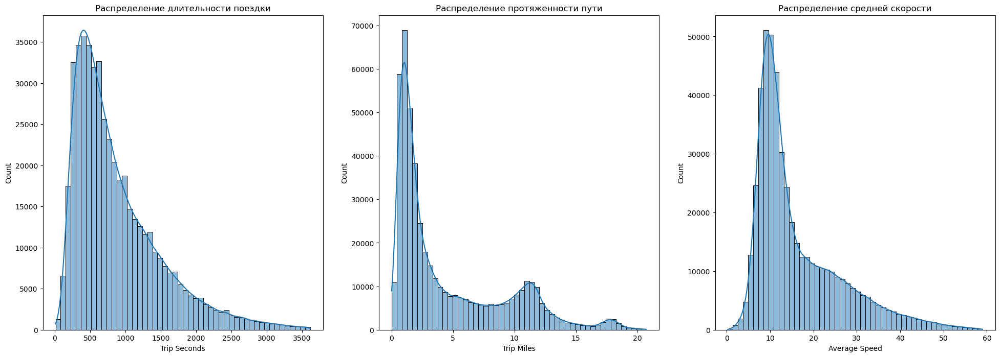

In [37]:
plt.figure(figsize=(24, 8))

plt.subplot(1, 3, 1)
sns.histplot(df['Trip Seconds'], bins=50, kde=True)
plt.title('Распределение длительности поездки')

plt.subplot(1, 3, 2)
sns.histplot(df['Trip Miles'], bins=50, kde=True)
plt.title('Распределение протяженности пути')

plt.subplot(1, 3, 3)
sns.histplot(df['Average Speed'], bins=50, kde=True)
plt.title('Распределение средней скорости')

plt.show()

Видно, что раcпределение длительности поездки является унимодальным, но не нормальным. Распределение протяженности пути в свою очередь является триимодальным. Найдем положения пиков.

In [38]:
from scipy.stats import mode

print(f'Мода длительности поездки: {mode(df['Trip Seconds'])[0]} с. с частотой {mode(df['Trip Seconds'])[1]}.')

Мода длительности поездки: 360.0 с. с частотой 5576.


In [39]:
print(f'Моды протяженности пути:',
      f'{mode(df[df['Trip Miles'] < 5]['Trip Miles'])[0]} миль с частотой {mode(df[df['Trip Miles'] < 5]['Trip Miles'])[1]}',
      f'{mode(df[df['Trip Miles'] > 5]['Trip Miles'])[0]} миль с частотой {mode(df[df['Trip Miles'] > 5]['Trip Miles'])[1]}',
      f'{mode(df[df['Trip Miles'] > 15]['Trip Miles'])[0]} миль с частотой {mode(df[df['Trip Miles'] > 15]['Trip Miles'])[1]}', sep='\n* ')

Моды протяженности пути:
* 0.8 миль с частотой 4704
* 11.2 миль с частотой 750
* 17.6 миль с частотой 165


In [40]:
print(f'Мода средней скорости: {mode(df['Average Speed'])[0]} миль/час с частотой {mode(df['Average Speed'])[1]}.')

Мода средней скорости: 12.0 миль/час с частотой 5023.


Можно предположить, что существуют некие популярные маршруты, из-за которых распределение протяженности пути носит тримодальный характер.

Далее вычислим основные статистические характеристики.

In [41]:
df['Trip Seconds'].describe()

count    487239.000000
mean        889.207487
std         620.675697
min          12.000000
25%         429.000000
50%         712.000000
75%        1189.000000
max        3615.000000
Name: Trip Seconds, dtype: float64

In [42]:
df['Trip Miles'].describe()

count    487239.000000
mean          4.601506
std           4.540544
min           0.020000
25%           1.150000
50%           2.330000
75%           7.600000
max          20.730000
Name: Trip Miles, dtype: float64

In [43]:
df['Average Speed'].describe()

count    487239.000000
mean         16.368320
std          10.005079
min           0.275422
25%           9.329843
50%          12.482412
75%          21.325328
max          58.985915
Name: Average Speed, dtype: float64

Посмотрим, насколько коррелируют Trip Seconds, Trip Miles и Average Speed.

In [44]:
df[['Trip Seconds', 'Trip Miles', 'Average Speed']].corr()

,Trip Seconds,Trip Miles,Average Speed
Trip Seconds,1.000000,0.773219,0.323772
Trip Miles,0.773219,1.000000,0.797759
Average Speed,0.323772,0.797759,1.000000


Высокая степень корреляции между длительностью и протяженностью поездки -- ожидаемое явление (обычно дольше=дальше), но еще более высокая степень корреляции между Trip Miles и Average Speed вызывает больше вопросов. Похоже, дальние перемещения проходят по участкам дорог, на которых трафик перемещается с большей средней скоростью (шоссе, высокоскоростные автодороги), а на участках с жилой застройкой тратится меньшая доля движения.

### 2. Оплата.
Тут посмотрим на распределения категорий оплаты.

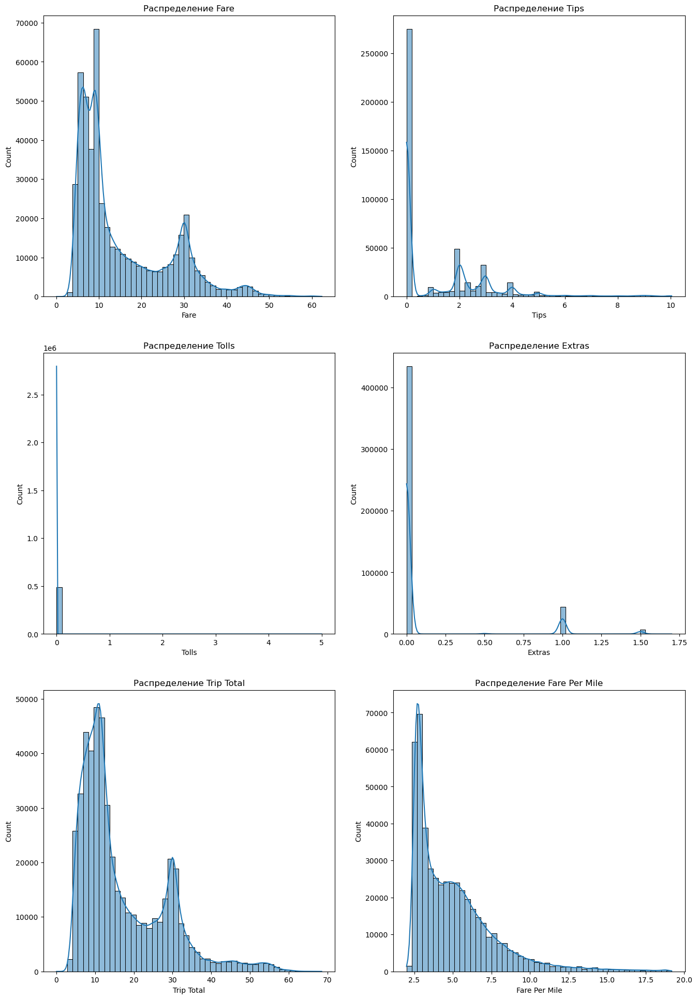

In [45]:
df['Fare Per Mile'] = df['Fare'] / df['Trip Miles']

features = ['Fare', 'Tips', 'Tolls', 'Extras', 'Trip Total', 'Fare Per Mile']

ncols = 2
nrows = len(features) // ncols + bool(len(features) % ncols)

plt.figure(figsize=(16, 24))

for id, feature in enumerate(features):
    plt.subplot(nrows, ncols, id+1)
    sns.histplot(df[feature], bins=50, kde=True)
    plt.title(f'Распределение {feature}')

plt.show()

Учитывая, что стоимость поездки Fare прямо зависит от протяженности пути, тримодальность распределения признака Fare (а также и признака Trip Total) вытекает из особенностей распределения признака Trip Miles. Проверим это через коэффициент корреляции. Для этого построим таблицу корреляций.

<Axes: >

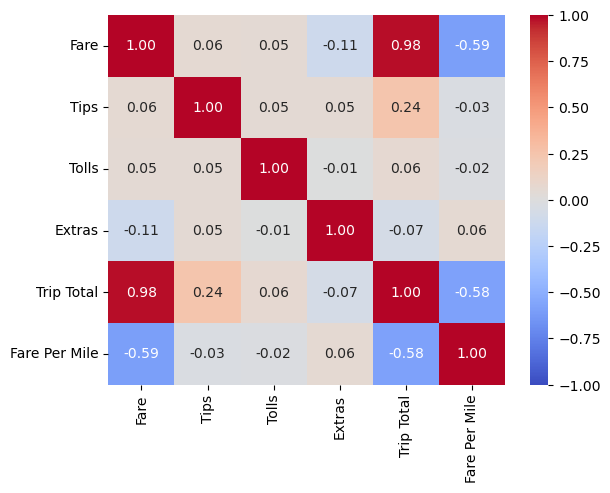

In [46]:
sns.heatmap(df[features].corr(), annot=True, fmt='.2f', vmin=-1, vmax='1', cmap='coolwarm')

Из полученной таблицы видны сильные корреляции между Fare и Trip Total (очевидно, Trip Total в большей степени составляет именно оплата проезда Fare). Также стоит заметить, что существует существенная обратная корреляция между Fare и Fare Per Mile. Это говорит о том, что с увеличением стоимости проезда, а значит и протяженности пути, стоимость одной мили пути будет уменьшаться. Это можно объяснить тем, что обычно в стоимость заказа такси включается так называемая "оплата вызова", которая составляет значительную долю чека на малых дистанциях и стремится к нулю на дальних.

Сейчас проверим связь тримодальности между Fare и Trip Miles. Для этого построим совместное распределение этих признаков. Если в местах наибольшей плотности точек будут одновременно наблюдаться пики в распределениях Fare и Trip Miles, то это будет говорить о том, что тримодальности связаны друг с другом. Так же это можно проверить просто вычислением корреляции между Fare и Trip Miles. Стоит ожидать высокой степени корреляции и совпадения пиков на графике совместного распределения.

Уменьшим число точек, взяв выборку в половину мощности датасета для ускорения построения.

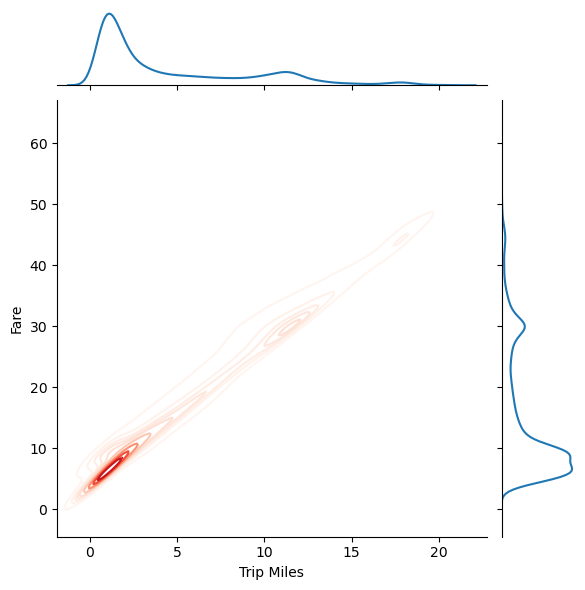

In [47]:
sns.jointplot(data=df.sample(frac=.2, random_state=37), x='Trip Miles', y='Fare', kind='kde', cmap='Reds', levels=10)

Из графика совместного распределения следует соответствие мод в распределениях Trip Miles и Fare, а значит и в распределениях Trip Miles и Trip Total. Это подтверждает сильную зависимость в указанных парах.

Дополнительно вычислим и коэффициент корреляции между ними.

In [48]:
from scipy.stats import pearsonr

print(f'Коэффициент корреляции Пирсона между признаками Fare и Trip Miles: {pearsonr(df['Fare'], df['Trip Miles'])[0]:.2f}.')

Коэффициент корреляции Пирсона между признаками Fare и Trip Miles: 0.98.


Мы убедились в связи тримодальностей распределений.

### 3. Категориальные признаки

Рассмотрим распределения категориальных признаков, как доли от общего числа поездок. Таким образом мы выясним наиболее популярные методы оплаты и компании-перевозчики.

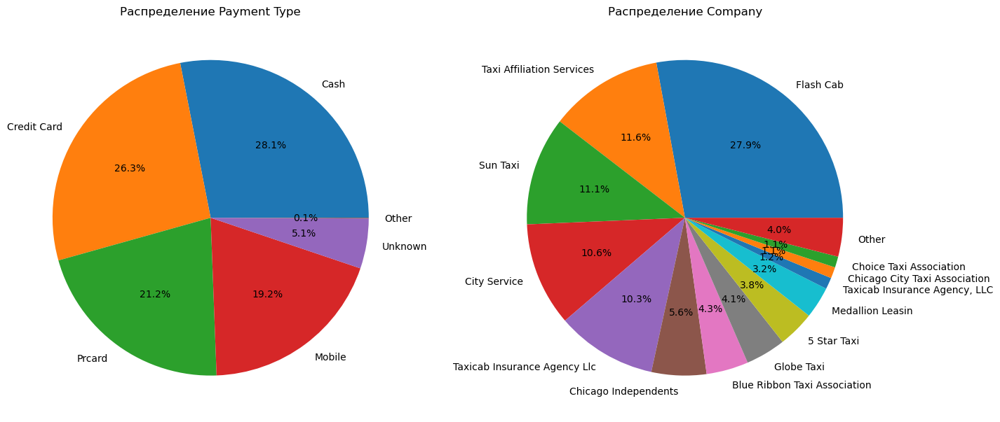

In [49]:
plt.figure(figsize=(16, 8))

payment_type_counts = df['Payment Type'].value_counts()
threshold = 0.05 * payment_type_counts.sum()

largest = payment_type_counts[payment_type_counts >= threshold]
smallest = pd.Series(payment_type_counts[payment_type_counts < threshold].sum(), ['Other'])

payment_type_counts = pd.concat([largest, smallest])

plt.subplot(1, 2, 1)
plt.pie(payment_type_counts, labels=payment_type_counts.index, autopct='%1.1f%%')
plt.title('Распределение Payment Type')

company_counts = df['Company'].value_counts()

threshold = 0.01 * company_counts.sum()
largest = company_counts[company_counts >= threshold]
smallest = pd.Series(company_counts[company_counts < threshold].sum(), ['Other'])

company_counts = pd.concat([largest, smallest])

plt.subplot(1, 2, 2)
plt.pie(company_counts, labels=company_counts.index, autopct='%1.1f%%')
plt.title('Распределение Company')

plt.show()

На круговых таблицах отлично видны распрдеелния как по способам оплаты, так и по компаниям. Наиболее популярные способы оплаты -- наличные и кредитные карты. Также популярными способами остаются Prcard и Mobile. Рынок среди компаний более разнообразен. Крупнейший перевозчик -- Flash Cab. Дальше по степени доли перевозок идут Taxi Affirmation Services, Sun Taxi, City Service, Taxicab Insurance Agency Llc. Остальные компании занимают каждая меньше 6% рынка.

### 4. География поездок

Мы подошли к географическим данным поездок: места начала и конца поездок. Начнем с тепловых карт, которые наглядно покажут распределение этих точек.

In [50]:
import folium
from folium.plugins import HeatMap

pickup_points = df[['Pickup Centroid Latitude', 'Pickup Centroid Longitude']].rename(columns={'Pickup Centroid Latitude': 'Latitude', 'Pickup Centroid Longitude': 'Longitude'})
dropoff_points = df[['Dropoff Centroid Latitude', 'Dropoff Centroid Longitude']].rename(columns={'Dropoff Centroid Latitude': 'Latitude', 'Dropoff Centroid Longitude': 'Longitude'})

In [51]:
center = [pickup_points['Latitude'].median(), pickup_points['Longitude'].median()]

m = folium.Map(location=center, zoom_start=11)

HeatMap(data=pickup_points.values, radius=10).add_to(m)

m

Теперь то же самое для точек назначения.

In [52]:
center = [dropoff_points['Latitude'].median(), dropoff_points['Longitude'].median()]

m = folium.Map(location=center, zoom_start=11)

HeatMap(data=dropoff_points.values, radius=10).add_to(m)

m

В целом, карты оказались близки друг к другу. Это совпадает с распределениями точек начала и конца поездки, где максимумы распределений лежат примерно в одинаковых областях. Основная масса точек лежит вблизи центра города и вдоль набережной озера. Также видно, что аэропорты являются точками интереса в смысле поездок на такси.

Карты выше могут отразить популярность определенных районов города в среднем, но по ним невозможно сделать никаких выводов о маршрутах. Попробуем изобразить подобную карту с тепловой картой маршрутов, чтобы определить популярные направления.

In [53]:
pickup_points['Latitude'].sample(2)

52209     41.986712
412191    41.878866
Name: Latitude, dtype: float64

In [54]:
routes = pd.DataFrame(data={'Start Latitude': pickup_points['Latitude'],
                            'Start Longitude': pickup_points['Longitude'],
                            'End Latitude': dropoff_points['Latitude'],
                            'End Longitude': dropoff_points['Longitude']})


In [55]:
def normalize(series):
    return (series - series.min()) / (series.max() - series.min())


routes = routes.groupby(by=['Start Latitude', 'Start Longitude', 'End Latitude', 'End Longitude']).size().reset_index(name='Frequency').sort_values(by='Frequency', ascending=False)
most_popular_route = routes.iloc[0]
routes = routes.iloc[1:]

routes['Normalized Frequency'] = normalize(routes['Frequency'])

routes.head()

,Start Latitude,Start Longitude,End Latitude,End Longitude,Frequency,Normalized Frequency
3530,41.878866,-87.625192,41.899602,-87.633308,7807,1.000000
5251,41.899602,-87.633308,41.878866,-87.625192,7537,0.965411
5257,41.899602,-87.633308,41.922686,-87.649489,6432,0.823853
3677,41.879255,-87.642649,41.880994,-87.632746,6388,0.818217
3997,41.884987,-87.620993,41.880994,-87.632746,6326,0.810274


In [56]:
most_popular_route.head()

Start Latitude        41.899602
Start Longitude      -87.633308
End Latitude          41.899602
End Longitude        -87.633308
Frequency          20863.000000
Name: 5254, dtype: float64

Мы вычислили популярность маршрутов в виде числа вызовов. В ней есть один очень популярный маршрут. Его обозначим отдельным зеленым цветом, выбросим из рассмотрения и перенормируем частоты. Это сделано выше.

Можно заметить, что координаты начала и конца поездки совпадают -- это может означать, что поездки совершались в пределах одного территориального района, то есть стоит ожидать, что протяженность таких поездок будет в основном небольшой, что можно будет позже проверить.

In [57]:
import matplotlib.colors as mcolors

m = folium.Map(location=[pickup_points['Latitude'].median(), pickup_points['Longitude'].median()], zoom_start=11)

# Самый популяный маршрут

points = [(most_popular_route['Start Latitude'], most_popular_route['Start Longitude']),
          (most_popular_route['End Latitude'], most_popular_route['End Longitude'])]

folium.PolyLine(locations=points, color='green', weight=20, oppacity=1).add_to(m)

# Остальные маршруты

cmap = mcolors.LinearSegmentedColormap.from_list("route_cmap", ["blue", "red"])


for _, route in routes.iterrows():
    points = [
        (route['Start Latitude'], route['Start Longitude']),
        (route['End Latitude'], route['End Longitude'])
    ]
    color = mcolors.to_hex(cmap(route['Normalized Frequency']))
    folium.PolyLine(locations=points, color=color, weight=1, opacity=0.02).add_to(m)

m


В итоге получилась карта маршрутов. Каких-либо серъезных выводов по ней сложно сделать. В дальнейшем стоит построить такие карты в зависимости от дня недели/времени суток, чтобы определить тенденции перемещения и их изменения.

### 5. Временные ряды

В этой части построим распределения поездок в зависимости от даты и времени суток.

Сначала выделим соответствующие признаки.

In [58]:
from datetime import datetime
for feature in ['Trip Start Timestamp', 'Trip End Timestamp']:
    df[f'{feature} Formated'] = pd.to_datetime(df[feature], format='%Y-%m-%d %X')

In [59]:
df['Start Date'] = pd.to_datetime(df['Trip Start Timestamp Formated'].dt.date.astype(str) + ' 00:00:00')
df['End Date'] = pd.to_datetime(df['Trip End Timestamp Formated'].dt.date.astype(str) + ' 00:00:00')

df['Start Day Of Week'] = df['Trip Start Timestamp Formated'].dt.day_of_week
df['End Day Of Week'] = df['Trip End Timestamp Formated'].dt.day_of_week

df['Start Time'] = pd.to_datetime('2000-01-01 '+df['Trip Start Timestamp Formated'].dt.time.astype(str))
df['End Time'] = pd.to_datetime('2000-01-01 '+df['Trip End Timestamp Formated'].dt.time.astype(str))


Пару слов перед построением графиков: стоит ожидать периодичности в распределении поездок по дням, поэтому дополнительно обозначим даты начала недель. Не стоит ожидать качественных отличий в распределениях Start Date и End Date, но построим все же оба распределения, чтобы удостовериться.

/tmp/ipykernel_152305/1696110429.py:7: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='center')
/tmp/ipykernel_152305/1696110429.py:14: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='center')


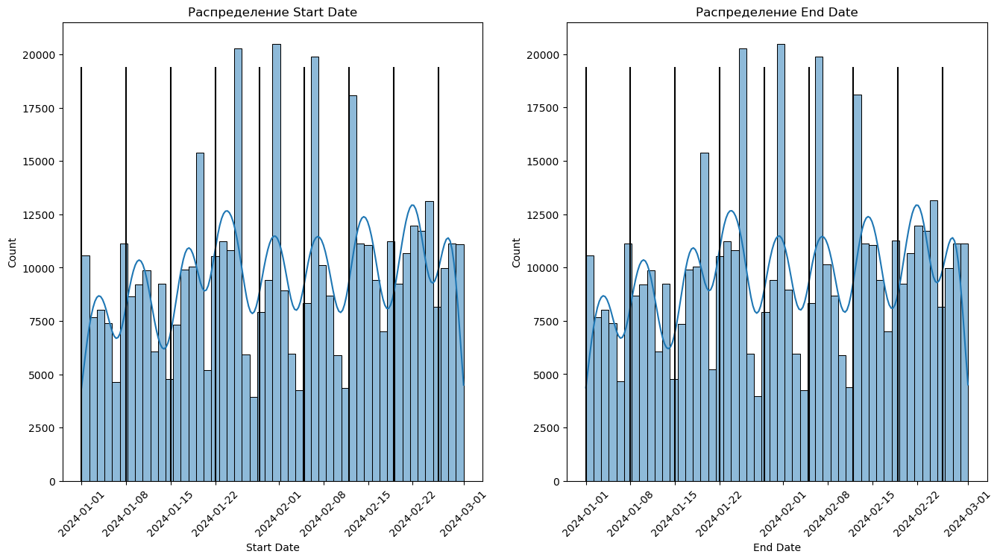

In [60]:
# Даты

plt.figure(figsize=(16, 8))

plt.subplot(1, 2, 1)
ax = sns.histplot(df['Start Date'], bins=50, kde=True, )
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='center')
plt.title('Распределение Start Date')
for date in df[df['Start Day Of Week'] == 0]['Start Date'].unique():
    plt.axvline(x=date, ymin=0, ymax=0.9, color='black', linestyle='-')

plt.subplot(1, 2, 2)
ax = sns.histplot(df['End Date'], bins=50, kde=True)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='center')
plt.title('Распределение End Date')
for date in df[df['End Day Of Week'] == 0]['End Date'].unique():
    plt.axvline(x=date, ymin=0, ymax=0.9, color='black', linestyle='-')

 
plt.show()

Отчетливо видна недельная периодичность количества поездок. Минимум, видимо, находится в воскресенье, а максимум в среду-четверг. Более подробно рассмотрим временные зависимости позже. Кроме этого число поездок в начале января в целом снижено, скорее всего, из-за новогодних и рождественских праздников.

В области перехода месяцев январь-февраль наблюдается значительное увеличение амплитуды по неизвестной пока что причине.

Теперь построим такие же распределения, но в зависимости от времени суток.

/tmp/ipykernel_152305/2684668156.py:12: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='center')
/tmp/ipykernel_152305/2684668156.py:21: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='center')


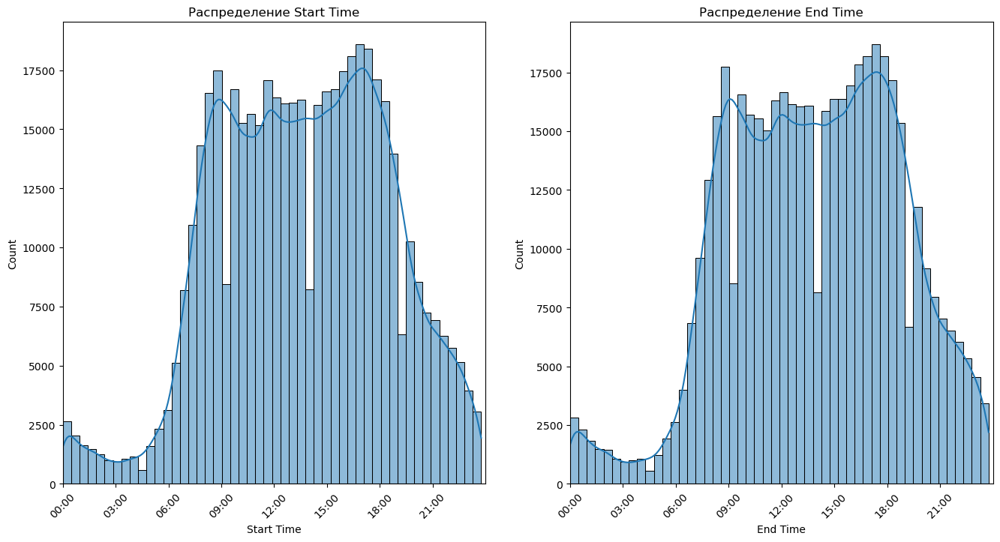

In [61]:
from matplotlib import dates as mdates
# Даты

plt.figure(figsize=(16, 8))

plt.subplot(1, 2, 1)
ax = sns.histplot(df['Start Time'], bins=50, kde=True)

ax.set_xlim(pd.to_datetime('2000-01-01 00:00:00'),
            pd.to_datetime('2000-01-01 23:59:59'))
ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='center')
plt.title('Распределение Start Time')

plt.subplot(1, 2, 2)
ax = sns.histplot(df['End Time'], bins=50, kde=True)

ax.set_xlim(pd.to_datetime('2000-01-01 00:00:00'),
            pd.to_datetime('2000-01-01 23:59:59'))
ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='center')
plt.title('Распределение End Time')

plt.show()

В среднем наиболее популярным временем пользования можно считать дневной промежуток времени с 9:00 до 18:00. Минимум приходится примерно на 3 часа ночи. Распределение выглядит вполне естественно.

### 6. Общий анализ корреляций.

Построим общую таблицу корреляций для всех числовых данных.
Для этого надо изменить формат временных признаков. Выразим дату как номер дня с начала года, а время в виде минут с начала суток.

In [62]:
df['Start Minutes'] = df['Start Time'].dt.hour*60 + df['Start Time'].dt.minute
df['End Minutes'] = df['End Time'].dt.hour*60 + df['End Time'].dt.minute

df['Start Days'] = df['Start Date'].dt.day_of_year
df['End Days'] = df['End Date'].dt.day_of_year


In [63]:
df.select_dtypes(['float', 'int']).columns

Index(['Trip Seconds', 'Trip Miles', 'Pickup Community Area',
       'Dropoff Community Area', 'Fare', 'Tips', 'Tolls', 'Extras',
       'Trip Total', 'Pickup Centroid Latitude', 'Pickup Centroid Longitude',
       'Dropoff Centroid Latitude', 'Dropoff Centroid Longitude',
       'Average Speed', 'Fare Per Mile', 'Start Day Of Week',
       'End Day Of Week', 'Start Minutes', 'End Minutes', 'Start Days',
       'End Days'],
      dtype='object')

In [64]:
features = ['Trip Seconds', 'Trip Miles',
            'Fare', 'Tips', 'Tolls', 'Extras', 'Trip Total',
            'Pickup Centroid Latitude', 'Pickup Centroid Longitude', 'Dropoff Centroid Latitude', 'Dropoff Centroid Longitude',
            'Average Speed', 'Fare Per Mile',
            'Start Day Of Week', 'End Day Of Week', 'Start Minutes', 'End Minutes', 'Start Days', 'End Days']

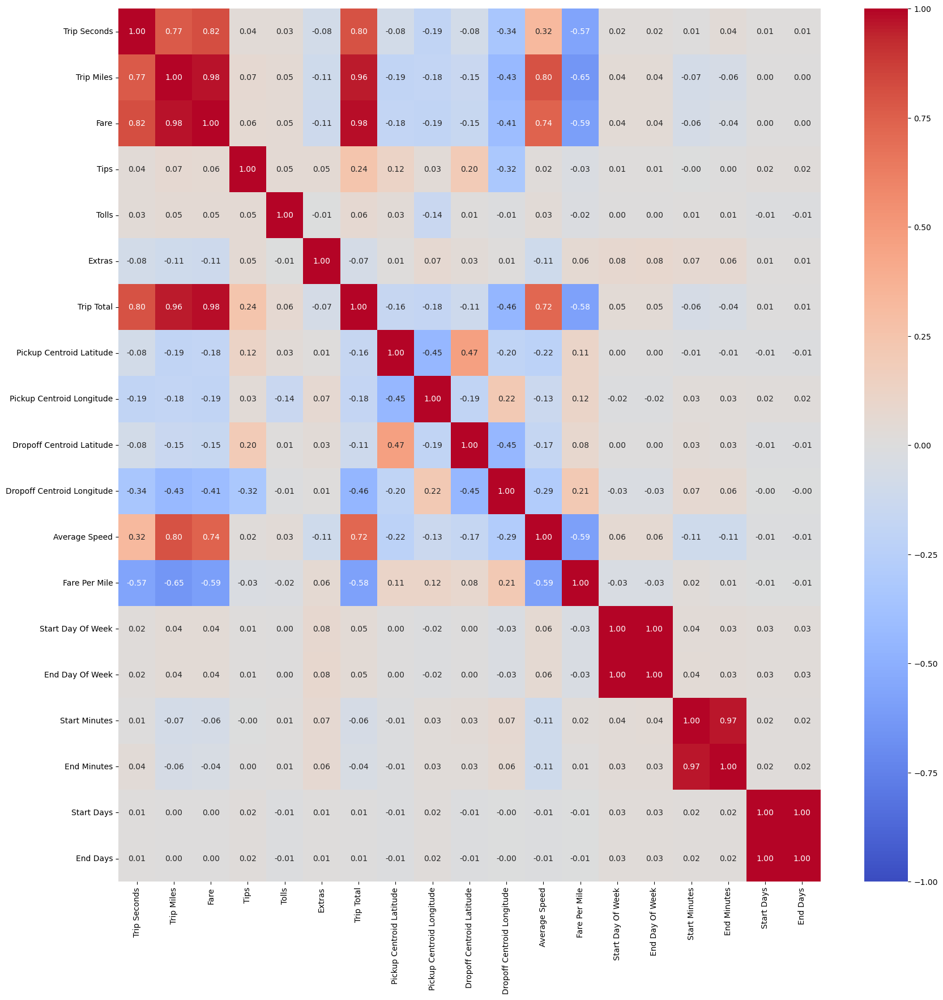

In [65]:
plt.figure(figsize=(20, 20))

sns.heatmap(df[features].corr(), annot=True, fmt='.2f', vmin=-1, vmax='1', cmap='coolwarm')

plt.show()

In [66]:
df.columns

Index(['Trip ID', 'Taxi ID', 'Trip Start Timestamp', 'Trip End Timestamp',
       'Trip Seconds', 'Trip Miles', 'Pickup Community Area',
       'Dropoff Community Area', 'Fare', 'Tips', 'Tolls', 'Extras',
       'Trip Total', 'Payment Type', 'Company', 'Pickup Centroid Latitude',
       'Pickup Centroid Longitude', 'Dropoff Centroid Latitude',
       'Dropoff Centroid Longitude', 'Average Speed', 'Fare Per Mile',
       'Trip Start Timestamp Formated', 'Trip End Timestamp Formated',
       'Start Date', 'End Date', 'Start Day Of Week', 'End Day Of Week',
       'Start Time', 'End Time', 'Start Minutes', 'End Minutes', 'Start Days',
       'End Days'],
      dtype='object')

Без подготовки данных ничего нового и интересного из таблицы мы не получили. Корреляции между Fare, Trip Seconds, Trip Miles, Average Speed были уже найдены ранее. Единственное, что можно отметить -- это отсутствие сезонности, то есть стоимость такси не меняется глобально с течением времени как в пределах одного дня так и в пределах датасета.

Далее перейдем к подробному анализу категорий оплаты Fare, Tips, Tolls, Extras и Trip Total.